<a href="https://colab.research.google.com/github/edwin-yan/Passion-Fruit-Disease-Detection/blob/andrew/Train_colab_augmented.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SET UP
## Mounting

Note that this assumes that your google drive folder has the same document layout. You must modify if that is not the case.


From your root Google Drive directory create a couple of folders:
* `JHU/DNN/FinalProject/Train_Images`
* `JHU/DNN/FinalProject/Test_Images` 

with Train and test images unzipped in those directories



In [1]:
# set GPU to nividia and display for confirmation
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)

# if unsuccessful, manual execution
if gpu_info.find('unsuccessful') >= 0:
  print('Use Runtime → "Change runtime type" menu option to execute manually.')
else:
  print(gpu_info)

Sun Nov 14 05:43:26 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **TODO:** GLOBAL VARIABLE set to `True` if using colab and `False` if not!

In [2]:
IS_COLAB = True 

# **TODO:** CHANGE `IMG_DIR` if your google drive directory is different

In [3]:
if IS_COLAB:
  from google.colab import drive
  drive.mount('/content/drive')
  IMG_PATH = '/content/drive/MyDrive/JHU/DNN/FinalProject'
else:
  IMG_PATH= '.'

Mounted at /content/drive


In [4]:
TRAIN_PATH = f'{IMG_PATH}/train_augmented_albumentations_df19aa9.csv'
TEST_PATH = f'{IMG_PATH}/Test.csv'

In [5]:
import time

t0 = time.time()

# !!TODO: you don't have to do this if you aren't using colab and your images are in a different directory!!
Copy test images from google drive to colab storage for speed:

Takes about 3 mins

In [6]:
! mkdir /content/datasets
! mkdir /content/datasets/Train

In [7]:
! ls

datasets  drive  sample_data


In [8]:
! cp -r {IMG_PATH}/Train_Images_Augmented /content/datasets/Train
# rename directory to match Edwin's
! mv /content/datasets/Train/Train_Images_Augmented /content/datasets/Train/images

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Imports

In [10]:
# Clone from repo and cd into repo
!git clone https://github.com/edwin-yan/Passion-Fruit-Disease-Detection

# Change directory
%cd Passion-Fruit-Disease-Detection

# Checkout specific branch
!git checkout andrew

Cloning into 'Passion-Fruit-Disease-Detection'...
remote: Enumerating objects: 369, done.
remote: Counting objects: 100% (369/369), done.
remote: Compressing objects: 100% (298/298), done.
remote: Total 369 (delta 155), reused 197 (delta 56), pack-reused 0
Receiving objects: 100% (369/369), 229.85 MiB | 15.20 MiB/s, done.
Resolving deltas: 100% (155/155), done.
/content/Passion-Fruit-Disease-Detection
Branch 'andrew' set up to track remote branch 'andrew' from 'origin'.
Switched to a new branch 'andrew'


In [11]:
!ls

Baseline_Model.ipynb
Eager_few_shot_od_training_colab_DNN_FINAL.ipynb
EDA_colab.ipynb
EDA.ipynb
helper.py
Image_Augmentation_colab.ipynb
Image_Augmentation_rotate_colab.ipynb
inference_colab.ipynb
Interactive_eager_few_shot_od_training_colab_DNN_FINAL.ipynb
Models
README.md
Test.csv
Test_Images
Train_colab_augmented.ipynb
Train_colab.ipynb
Train.csv
Train_Images
yolo5Input


In [12]:
import pandas as pd
from helper import plot_sample_images, plot_sample_images_multi

In [13]:
df_train, df_test = pd.read_csv(TRAIN_PATH), pd.read_csv(TEST_PATH)
print(f"Training Data Shape:  {df_train.shape}\nTest Data Shape:      {df_test.shape}")

Training Data Shape:  (7809, 6)
Test Data Shape:      (931, 1)


In [14]:
df_train.Image_ID.value_counts().head(10)

ID_OYN556Y0    5
ID_M34YFAR2    5
ID_AF7K88JS    5
ID_XEMG90OT    5
ID_LZI2KVVE    5
ID_W18N80QY    4
ID_5FFI5RKO    4
ID_5LSWR9I5    4
ID_1TJA8V5E    4
ID_NCXRHK4H    4
Name: Image_ID, dtype: int64

In [15]:
df_train['class'].value_counts()

fruit_healthy      3275
fruit_woodiness    2490
fruit_brownspot    2044
Name: class, dtype: int64

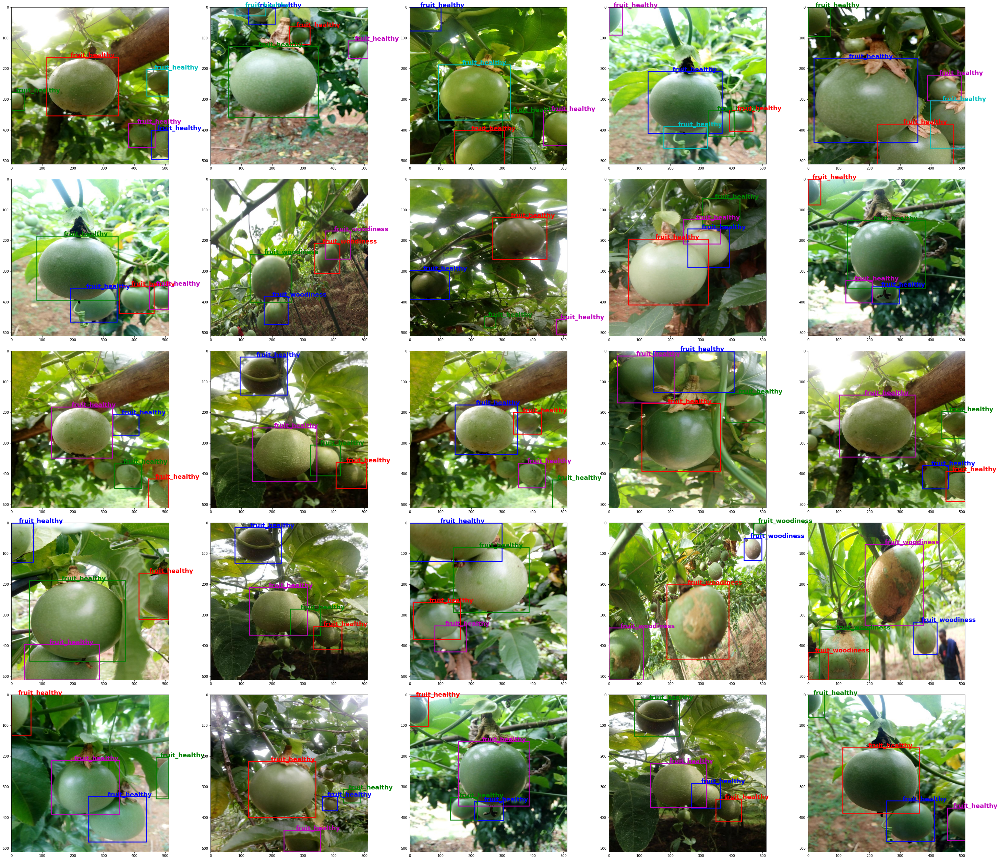

In [16]:
plot_sample_images_multi(df_train,dir_path=IMG_PATH)

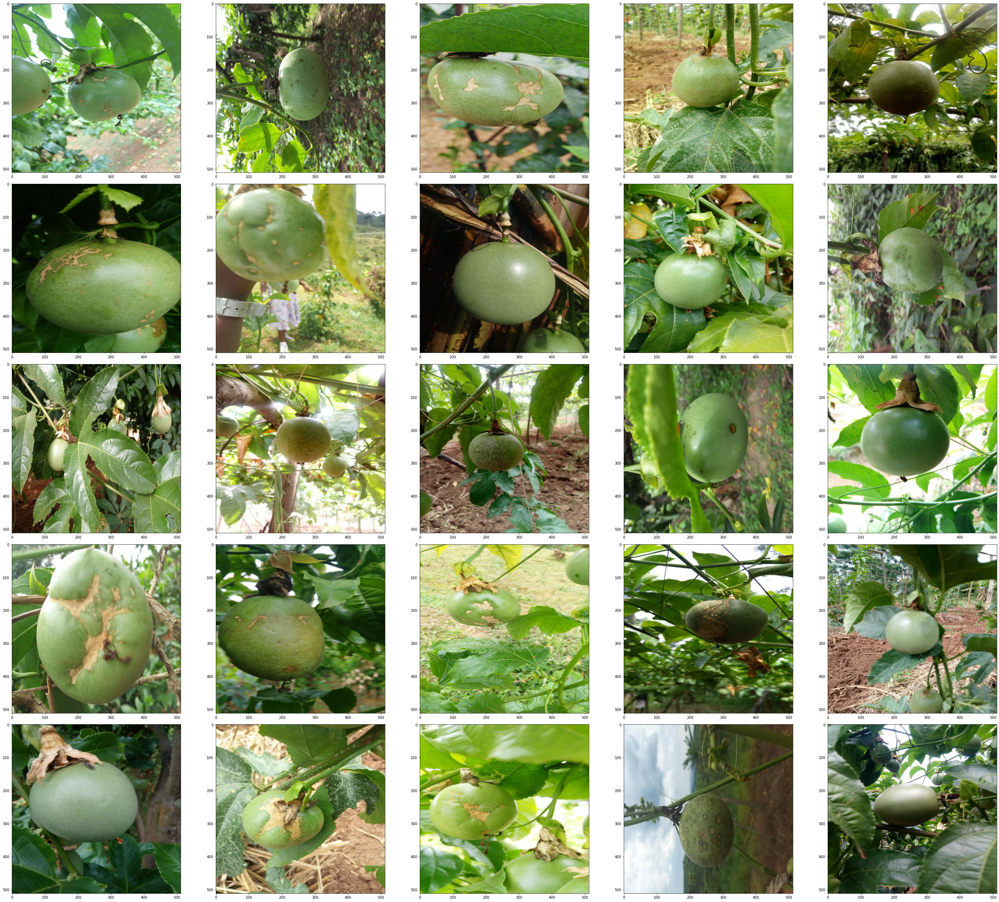

In [17]:
plot_sample_images_multi(df_test, show_label=False, is_train=False,dir_path=IMG_PATH)

# Convert to YOLO 5 annotation format

https://roboflow.com/formats/yolov5-pytorch-txt

Each image has one txt file with a single line for each bounding box. The format of each row is 

`class_id center_x center_y width height`

ASSUMPTION: Image size is 512 x 512: https://zindi.africa/competitions/makerere-passion-fruit-disease-detection-challenge/data
```
The dataset contains about 4000 images resized to 512x512.
```

In [18]:
IMG_HEIGHT = 512
IMG_WIDTH = 512

In [19]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height
0,ID_007FAIEI,fruit_woodiness,87.0,87.5,228.0,311.0
1,ID_00G8K1V3,fruit_brownspot,97.5,17.5,245.0,354.5
2,ID_00WROUT9,fruit_brownspot,156.5,209.5,248.0,302.5
3,ID_00ZJEEK3,fruit_healthy,125.0,193.0,254.5,217.0
4,ID_018UIENR,fruit_brownspot,79.5,232.5,233.5,182.0


Normalize Data:

In [20]:
df_train['xmin'] = df_train['xmin']/IMG_WIDTH
df_train['ymin'] = df_train['ymin']/IMG_HEIGHT
df_train['width'] = df_train['width']/IMG_WIDTH
df_train['height'] = df_train['height']/IMG_HEIGHT

In [21]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469


Add columns for center

In [22]:
# get center_x
df_train['center_x'] = df_train['xmin'] + df_train['width']/2

In [23]:
# get center_y
df_train['center_y'] = df_train['ymin'] + df_train['height']/2

Add columns for class index

In [24]:
# Use .apply to map class to integer:
# https://stackoverflow.com/questions/50002738/replacing-a-string-by-an-integer-dictionary-in-python-pandas-dataframe
class_dic = {
    'fruit_healthy':0,
    'fruit_woodiness':1,
    'fruit_brownspot':2
}
df_train['class_ints'] = df_train['class']
df_train['class_ints']=df_train['class_ints'].apply(lambda x: class_dic.get(x))


In [25]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height,center_x,center_y,class_ints
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422,0.392578,0.474609,1
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383,0.429688,0.380371,2
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820,0.547852,0.704590,2
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828,0.492676,0.588867,0
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469,0.383301,0.631836,2


Loop through each column and write to csv per image,
selecting per value, then write to .csv

To get unique columns:
https://www.statology.org/pandas-unique-values-in-column/

To get all rows with value
https://stackoverflow.com/questions/17071871/how-do-i-select-rows-from-a-dataframe-based-on-column-values

Create directory for input.

NOTE: the .txt files are git ignored to keep the repo small

In [26]:
# Change directory
%cd /content/datasets/Train
!ls

/content/datasets/Train
images


In [27]:
from pathlib import Path
Path("labels").mkdir(parents=True, exist_ok=True)

In [28]:
%cd /content/datasets/Train/labels

/content/datasets/Train/labels


In [29]:
for img_name in df_train['Image_ID'].unique():

  # grab rows with this id
  df_train_yolo5 = df_train[df_train['Image_ID'] == img_name]
  # keep only the columsn that yolo 5 needs
  df_train_yolo5 = df_train_yolo5[['class_ints','center_x',	'center_y',	'width',	'height']]
  # write to txt file via to_csv
  # https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_csv.html
  # https://stackoverflow.com/questions/16923281/writing-a-pandas-dataframe-to-csv-file
  # https://stackoverflow.com/questions/31247198/python-pandas-write-content-of-dataframe-into-text-file
  df_train_yolo5.to_csv(f'{img_name}.txt', encoding='utf-8',header=False, index=False, sep=' ', mode='a')

In [30]:
!ls

ID_007FAIEI_15ed3d5c-44ef-11ec-b5b1-0242ac1c0002.txt
ID_007FAIEI.txt
ID_00G8K1V3_163a1ec4-44ef-11ec-b5b1-0242ac1c0002.txt
ID_00G8K1V3.txt
ID_00WROUT9_1683211e-44ef-11ec-b5b1-0242ac1c0002.txt
ID_00WROUT9.txt
ID_00ZJEEK3_16d4b358-44ef-11ec-b5b1-0242ac1c0002.txt
ID_00ZJEEK3.txt
ID_018UIENR_171de4b0-44ef-11ec-b5b1-0242ac1c0002.txt
ID_018UIENR.txt
ID_01QZDXVQ_176c7b5c-44ef-11ec-b5b1-0242ac1c0002.txt
ID_01QZDXVQ.txt
ID_02PX7GI8_17dd95b2-44ef-11ec-b5b1-0242ac1c0002.txt
ID_02PX7GI8_182a30d4-44ef-11ec-b5b1-0242ac1c0002.txt
ID_02PX7GI8.txt
ID_03WE3EVQ_1877dc08-44ef-11ec-b5b1-0242ac1c0002.txt
ID_03WE3EVQ.txt
ID_052XYWUM_18c6843e-44ef-11ec-b5b1-0242ac1c0002.txt
ID_052XYWUM.txt
ID_055U1LPM_1915e254-44ef-11ec-b5b1-0242ac1c0002.txt
ID_055U1LPM.txt
ID_058OQ45J_196a32fa-44ef-11ec-b5b1-0242ac1c0002.txt
ID_058OQ45J.txt
ID_05A7I1ZP_19bfe4f2-44ef-11ec-b5b1-0242ac1c0002.txt
ID_05A7I1ZP_1a158c0e-44ef-11ec-b5b1-0242ac1c0002.txt
ID_05A7I1ZP.txt
ID_05G9F711_1a6c1f88-44ef-11ec-b5b1-0242ac1c0002.txt
ID_05G9F711.t

# Clone YOLO v5 Repo

Move back to /content directory

In [31]:
%cd /content

/content


In [32]:

!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 9904, done.
remote: Total 9904 (delta 0), reused 0 (delta 0), pack-reused 9904
Receiving objects: 100% (9904/9904), 10.30 MiB | 24.52 MiB/s, done.
Resolving deltas: 100% (6864/6864), done.
/content/yolov5
     |████████████████████████████████| 596 kB 12.0 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [33]:
%cd yolov5

[Errno 2] No such file or directory: 'yolov5'
/content/yolov5


In [34]:
! pwd

/content/yolov5


Copy .yaml to /yolov5/dataset

In [35]:
! cp -r {IMG_PATH}/passion_fruit.yaml /content/yolov5/data

In [36]:
! python train.py --img 512 --batch 32 --epochs 150 --data passion_fruit.yaml --weights yolov5s.pt


train: weights=yolov5s.pt, cfg=, data=passion_fruit.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=150, batch_size=32, imgsz=512, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-88-g80cfaf4 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.

In [37]:
!cp /content/yolov5/runs/train/exp/weights/best.pt {IMG_PATH}

In [38]:
tend = time.time()
print('Elapsed time: ', (tend-t0)/60, ' minutes')

Elapsed time:  566.2140830715497  minutes
